In [1]:
import numpy as np
import pandas as pd
from shapely.geometry import Polygon,box,Point
import os
os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd

import osmnx as ox
import networkx as nx
from osmnx.distance import nearest_nodes

import matplotlib.pyplot as plt
import random

from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from matplotlib.collections import LineCollection
from matplotlib.lines import Line2D
from shapely.geometry import MultiLineString

In [2]:
aq = gpd.read_file(r'C:\Users\zliu33\Downloads\filtered_aq_1.geojson')

aq.head()

,FID,RecID,CO,PM25,PM10,NOx_ppb,geometry
0,49994747,86784,23.2606,0.390171,0.875590,1.37965,"POLYGON ((-71.14291 42.21430, -71.14291 42.214..."
1,49994748,86785,22.9568,0.385104,0.864172,1.40085,"POLYGON ((-71.14278 42.21430, -71.14278 42.214..."
2,49994749,86786,22.6697,0.380315,0.853379,1.42454,"POLYGON ((-71.14266 42.21430, -71.14266 42.214..."
3,49994750,86787,22.4037,0.375879,0.843380,1.45100,"POLYGON ((-71.14254 42.21430, -71.14254 42.214..."
4,49994751,86788,22.2122,0.372693,0.836174,1.48041,"POLYGON ((-71.14242 42.21430, -71.14242 42.214..."


In [4]:
# read in osm file
G1 = ox.graph.graph_from_xml(r'C:\Users\zliu33\Downloads\Bosbike_new.osm', bidirectional=False, simplify=True)

C:\JumboConda\lib\site-packages\osmnx\graph.py:551: UserWarning: The XML file you are loading appears to have been generated by OSMnx: this use case is not supported and may not behave as expected. To save/load graphs to/from disk for later use in OSMnx, use the `io.save_graphml` and `io.load_graphml` functions instead. Refer to the documentation for details.
  response_jsons = [osm_xml._overpass_json_from_file(filepath)]


In [5]:
gdf_nodes1, gdf_edges1 = ox.utils_graph.graph_to_gdfs(G1, nodes=True, edges=True, node_geometry=True, fill_edge_geometry=True)


In [6]:
gdf_nodes1[:3]

,y,x,highway,geometry
osmid,,,,
21321186,42.483945,-71.219512,NaN,POINT (-71.21951 42.48394)
21321216,42.476683,-71.214538,NaN,POINT (-71.21454 42.47668)
30730954,42.367608,-71.021817,NaN,POINT (-71.02182 42.36761)


In [8]:
gdf_edges1

osmid  oneway lanes                name  \
u           v           key                                             
21321186    472386433   0         0    True     3  Middlesex Turnpike   
21321216    1793674713  0         1   False     2        Summit Drive   
                        1    197940   False     2        Summit Drive   
            8213948692  0         2    True     2  Middlesex Turnpike   
30730954    8246764113  0         3   False   NaN  Logan Memorial Way   
...                             ...     ...   ...                 ...   
11728814820 11728814821 0    385195   False   NaN                 NaN   
                        1    385197   False   NaN                 NaN   
            11728814819 0    385196    True   NaN                 NaN   
11728814821 11728814820 0    385195   False   NaN                 NaN   
                        1    385197   False   NaN                 NaN   

                                  highway maxspeed  reversed   length  \
u           v           key                                             
21321186    472386433   0       secondary   35 mph     False  362.821   
21321216    1793674713  0    unclassified      NaN     False   48.047   
                        1    unclassified      NaN      True   48.047   
            8213948692  0       secondary   35 mph     False   28.484   
30730954    8246764113  0     residential   25 mph     False    7.148   
...                                   ...      ...       ...      ...   
11728814820 11728814821 0         service      NaN     False   17.885   
                        1         service      NaN      True   17.885   
            11728814819 0         service      NaN     False   18.325   
11728814821 11728814820 0         service      NaN      True   17.885   
                        1         service      NaN     False   17.885   

                                                                      geometry  
u           v           key                                                     
21321186    472386433   0    LINESTRING (-71.21951 42.48394, -71.21744 42.4...  
21321216    1793674713  0    LINESTRING (-71.21454 42.47668, -71.21511 42.4...  
                        1    LINESTRING (-71.21454 42.47668, -71.21511 42.4...  
            8213948692  0    LINESTRING (-71.21454 42.47668, -71.21441 42.4...  
30730954    8246764113  0    LINESTRING (-71.02182 42.36761, -71.02184 42.3...  
...                                                                        ...  
11728814820 11728814821 0    LINESTRING (-71.12215 42.37275, -71.12205 42.3...  
                        1    LINESTRING (-71.12215 42.37275, -71.12205 42.3...  
            11728814819 0    LINESTRING (-71.12215 42.37275, -71.12195 42.3...  
11728814821 11728814820 0    LINESTRING (-71.12205 42.37289, -71.12215 42.3...  
                        1    LINESTRING (-71.12205 42.37289, -71.12215 42.3...  

[729346 rows x 9 columns]

In [9]:
edge_aq_intersect1 = gpd.sjoin(gdf_edges1,aq,op='intersects')
edge_aq_intersect1 = edge_aq_intersect1.reset_index(['u', 'v', 'key'])
edge_aq_intersect1

C:\JumboConda\lib\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,u,v,key,osmid,oneway,lanes,name,highway,maxspeed,reversed,length,geometry,index_right,FID,RecID,CO,PM25,PM10,NOx_ppb
0,30730954,8246764113,0,3,False,NaN,Logan Memorial Way,residential,25 mph,False,7.148,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
1,30730954,8246764113,1,349120,False,NaN,Logan Memorial Way,residential,25 mph,True,7.148,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
2,30730955,8246764113,0,5,False,NaN,Logan Memorial Way,residential,25 mph,False,2.662,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
3,30730955,8246764113,1,349119,False,NaN,Logan Memorial Way,residential,25 mph,True,2.662,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
4,30730955,5325689133,0,6,False,NaN,NaN,service,NaN,False,46.079,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3309067,11728768467,1522224095,0,385192,True,2,Cambridge Street,primary,25 mph,False,21.473,"LINESTRING (-71.06366 42.36117, -71.06340 42.3...",3194530,66369009,91774,49.8283,0.963176,2.270340,13.84900
3309068,11728814819,11728814820,0,385194,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12195 42.37268, -71.12215 42.3...",3443691,67647249,189523,20.8349,0.389485,0.901769,1.94371
3309069,11728814820,11728814819,0,385196,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12215 42.37275, -71.12195 42.3...",3443691,67647249,189523,20.8349,0.389485,0.901769,1.94371
3309070,11728814819,11728814820,0,385194,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12195 42.37268, -71.12215 42.3...",3445809,67657239,190126,20.7802,0.388964,0.554318,2.04005


In [ ]:
# For PM25

In [10]:
edge_aq_grouped1 = edge_aq_intersect1.groupby(['u','v','key'])['PM25'].sum().reset_index(['u','v','key']).rename(columns={'sum':'PM25'})
edge_aq_grouped1

,u,v,key,PM25
0,30730954,61441677,0,0.894345
1,30730954,8246764113,0,0.445659
2,30730954,8246764113,1,0.445659
3,30730955,5325689133,0,1.734852
4,30730955,5325689133,1,1.734852
...,...,...,...,...
350859,11728814820,11728814819,0,1.594618
350860,11728814820,11728814821,0,1.547198
350861,11728814820,11728814821,1,1.547198
350862,11728814821,11728814820,0,1.547198


In [11]:
# spatial join network and aq
gdf_edges1_copy = gdf_edges1.copy()

edge_aq_intersect1_copy = gpd.sjoin(gdf_edges1_copy,aq,op='intersects')
edge_aq_intersect1_copy = edge_aq_intersect1_copy.reset_index(['u', 'v', 'key'])
edge_aq_intersect1_copy

C:\JumboConda\lib\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,u,v,key,osmid,oneway,lanes,name,highway,maxspeed,reversed,length,geometry,index_right,FID,RecID,CO,PM25,PM10,NOx_ppb
0,30730954,8246764113,0,3,False,NaN,Logan Memorial Way,residential,25 mph,False,7.148,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
1,30730954,8246764113,1,349120,False,NaN,Logan Memorial Way,residential,25 mph,True,7.148,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
2,30730955,8246764113,0,5,False,NaN,Logan Memorial Way,residential,25 mph,False,2.662,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
3,30730955,8246764113,1,349119,False,NaN,Logan Memorial Way,residential,25 mph,True,2.662,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
4,30730955,5325689133,0,6,False,NaN,NaN,service,NaN,False,46.079,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3309067,11728768467,1522224095,0,385192,True,2,Cambridge Street,primary,25 mph,False,21.473,"LINESTRING (-71.06366 42.36117, -71.06340 42.3...",3194530,66369009,91774,49.8283,0.963176,2.270340,13.84900
3309068,11728814819,11728814820,0,385194,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12195 42.37268, -71.12215 42.3...",3443691,67647249,189523,20.8349,0.389485,0.901769,1.94371
3309069,11728814820,11728814819,0,385196,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12215 42.37275, -71.12195 42.3...",3443691,67647249,189523,20.8349,0.389485,0.901769,1.94371
3309070,11728814819,11728814820,0,385194,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12195 42.37268, -71.12215 42.3...",3445809,67657239,190126,20.7802,0.388964,0.554318,2.04005


In [ ]:
### Plot for PM25

In [12]:
edge_aq_grouped1_copy = edge_aq_intersect1_copy.groupby(['u','v','key','geometry'])['PM25'].sum().reset_index(['u','v','key','geometry']).rename(columns={'sum':'PM25'})
edge_aq_grouped1_copy

,u,v,key,geometry,PM25
0,30730954,61441677,0,"LINESTRING (-71.02182 42.36761, -71.02175 42.3...",0.894345
1,30730954,8246764113,0,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",0.445659
2,30730954,8246764113,1,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",0.445659
3,30730955,5325689133,0,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",1.734852
4,30730955,5325689133,1,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",1.734852
...,...,...,...,...,...
350859,11728814820,11728814819,0,"LINESTRING (-71.12215 42.37275, -71.12195 42.3...",1.594618
350860,11728814820,11728814821,0,"LINESTRING (-71.12215 42.37275, -71.12205 42.3...",1.547198
350861,11728814820,11728814821,1,"LINESTRING (-71.12215 42.37275, -71.12205 42.3...",1.547198
350862,11728814821,11728814820,0,"LINESTRING (-71.12205 42.37289, -71.12215 42.3...",1.547198


In [13]:
# Count NaN of NOx_ppb
nan_count1 = edge_aq_grouped1['PM25'].isna().sum()

# Print the count of NaN values
print(f"Number of NaN values in 'PM25': {nan_count1}")

# no NaN

Number of NaN values in 'PM25': 0


In [14]:
print(edge_aq_intersect1['PM25'].max())
print(edge_aq_grouped1['PM25'].max())

27.9175
1374.79393


In [ ]:
### break

In [15]:
sch_bos = gpd.read_file(r'C:\Users\zliu33\Downloads\Pre-kindergarten to High School Buildings\GISDATA_SCHOOLS_PTPoint.shp')
sch_bos.head()

,schid,name,address,town_mail,town,zipcode,phone,grades,type,type_desc,dist_name,dist_code,ma_addr_id,type_desc2,geometry
0,02480305,Susan B. Anthony Middle School,107 Newhall Street,Revere,REVERE,02151,781-388-7520,"06,07,08",MID,Public Middle,Revere,02480000,3537730,NaN,POINT (-71.02088 42.41980)
1,03440045,Ambrose Elementary School,27 High Street,Winchester,WINCHESTER,01890,781-721-7012,"K,01,02,03,04,05",ELE,Public Elementary,Winchester,03440000,4176013,NaN,POINT (-71.15615 42.44574)
2,02290015,Center School,18 Irving Street,Peabody,PEABODY,01960,978-536-5475,"K,01,02,03,04,05",ELE,Public Elementary,Peabody,02290000,3723026,NaN,POINT (-70.94457 42.52954)
3,02200020,John P Oldham School,165 Prospect Street,Norwood,NORWOOD,02062,781-769-2417,"01,02,03,04,05",ELE,Public Elementary,Norwood,02200000,3102349,NaN,POINT (-71.20483 42.20407)
4,01000302,Cameron Middle School,215 Elm Street,Framingham,FRAMINGHAM,01701,508-879-2290,"06,07,08",MID,Public Middle,Framingham,01000000,4122188,NaN,POINT (-71.39994 42.33321)


In [16]:
sch_bos = sch_bos[sch_bos['type'] == 'ELE']
sch_bos.head()

,schid,name,address,town_mail,town,zipcode,phone,grades,type,type_desc,dist_name,dist_code,ma_addr_id,type_desc2,geometry
1,03440045,Ambrose Elementary School,27 High Street,Winchester,WINCHESTER,01890,781-721-7012,"K,01,02,03,04,05",ELE,Public Elementary,Winchester,03440000,4176013,NaN,POINT (-71.15615 42.44574)
2,02290015,Center School,18 Irving Street,Peabody,PEABODY,01960,978-536-5475,"K,01,02,03,04,05",ELE,Public Elementary,Peabody,02290000,3723026,NaN,POINT (-70.94457 42.52954)
3,02200020,John P Oldham School,165 Prospect Street,Norwood,NORWOOD,02062,781-769-2417,"01,02,03,04,05",ELE,Public Elementary,Norwood,02200000,3102349,NaN,POINT (-71.20483 42.20407)
5,02290010,Thomas Carroll School,60 Northend Street,Peabody,PEABODY,01960,978-536-4200,"PK,K,01,02,03,04,05",ELE,Public Elementary,Peabody,02290000,3712485,NaN,POINT (-70.91764 42.53227)
8,01420015,Lillian M. Jacobs School,18 Harborview Road,Hull,HULL,02045,781-925-4400,"PK,K,01,02,03,04,05,06",ELE,Public Elementary,Hull,01420000,3461733,NaN,POINT (-70.90887 42.30679)


In [17]:
sch_bos.shape

(410, 15)

In [18]:
region_bounds = (-71.22648, 42.21433, -70.967401, 42.44459)

sch_bos = sch_bos.clip(mask=region_bounds)
sch_bos.shape

(199, 15)

In [19]:
# Step 1: Ensure correct data types for 'u', 'v', and 'key' in edge_aq_grouped1
edge_aq_grouped1['u'] = edge_aq_grouped1['u'].astype(int)
edge_aq_grouped1['v'] = edge_aq_grouped1['v'].astype(int)
edge_aq_grouped1['key'] = edge_aq_grouped1['key'].astype(int)

# Step 2: Create a dictionary with edge attributes from edge_aq_grouped1
edge_attr_dict2 = {
    (row['u'], row['v'], row['key']): row['PM25']
    for idx, row in edge_aq_grouped1.iterrows()
}

# Step 3: Assign 'NOx_ppb' to the edges in G1 if they exist in edge_attr_dict2
for u, v, key, data in G1.edges(keys=True, data=True):
    # Convert u, v, and key to int, assuming they are integers in G1
    u, v, key = int(u), int(v), int(key)
    if (u, v, key) in edge_attr_dict2:
        data['PM25'] = edge_attr_dict2[(u, v, key)]

# Optional: Confirm if NOx_ppb is added
# This will print the first edge data that has NOx_ppb added, for confirmation
for u, v, data in G1.edges(data=True):
    if 'PM25' in data:
        print(f"Edge from {u} to {v} has the following data: {data}")
        break

Edge from 30730954 to 61441677 has the following data: {'osmid': 4, 'oneway': True, 'lanes': '2', 'name': 'Logan Memorial Way', 'highway': 'residential', 'maxspeed': '25 mph', 'reversed': False, 'length': 33.098, 'PM25': 0.894345}


In [20]:
edge_aq_grouped1[(edge_aq_grouped1['u'] == 30730955)]

,u,v,key,PM25
3,30730955,1030721837,0,1.734852
4,30730955,1030721837,1,1.734852
5,30730955,-343170479,0,0.202321
6,30730955,-343170479,1,0.202321
7,30730955,1371152769,0,0.899122
8,30730955,1371152769,1,0.899122


In [21]:
edge_aq_grouped1_copy[(edge_aq_grouped1_copy['u'] == 30730955)]

,u,v,key,geometry,PM25
3,30730955,5325689133,0,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",1.734852
4,30730955,5325689133,1,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",1.734852
5,30730955,8246764113,0,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",0.202321
6,30730955,8246764113,1,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",0.202321
7,30730955,9961087361,0,"LINESTRING (-71.02185 42.36752, -71.02196 42.3...",0.899122
8,30730955,9961087361,1,"LINESTRING (-71.02185 42.36752, -71.02196 42.3...",0.899122


In [23]:
# Step 2: Create a dictionary with edge attributes from edge_aq_grouped1
edge_attr_dict2_copy = {
    (row['u'], row['v'], row['key']): row['PM25']
    for idx, row in edge_aq_grouped1_copy.iterrows()
}

# Step 3: Assign 'NOx_ppb' to the edges in G1 if they exist in edge_attr_dict2
for u, v, key, data in G1_copy.edges(keys=True, data=True):
    # Convert u, v, and key to int, assuming they are integers in G1
    u, v, key = int(u), int(v), int(key)
    if (u, v, key) in edge_attr_dict2_copy:
        data['PM25'] = edge_attr_dict2_copy[(u, v, key)]

# Optional: Confirm if NOx_ppb is added
# This will print the first edge data that has NOx_ppb added, for confirmation
for u, v, data in G1_copy.edges(data=True):
    if 'PM25' in data:
        print(f"Edge from {u} to {v} has the following data: {data}")
        break

NameError: name 'G1_copy' is not defined

In [24]:
edge_aq_grouped1_copy[(edge_aq_grouped1_copy['u'] == 30730955)]

,u,v,key,geometry,PM25
3,30730955,5325689133,0,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",1.734852
4,30730955,5325689133,1,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",1.734852
5,30730955,8246764113,0,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",0.202321
6,30730955,8246764113,1,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",0.202321
7,30730955,9961087361,0,"LINESTRING (-71.02185 42.36752, -71.02196 42.3...",0.899122
8,30730955,9961087361,1,"LINESTRING (-71.02185 42.36752, -71.02196 42.3...",0.899122


In [ ]:
### start plot

In [25]:
from shapely import wkt

# If the geometry column is in WKT format (as a string), convert it to shapely geometry objects
if isinstance(edge_aq_grouped1_copy['geometry'].iloc[0], str):
    edge_aq_grouped1_copy['geometry'] = edge_aq_grouped1_copy['geometry'].apply(wkt.loads)

# Then convert to GeoDataFrame
gdf_edge_aq_grouped1 = gpd.GeoDataFrame(edge_aq_grouped1_copy, geometry='geometry')

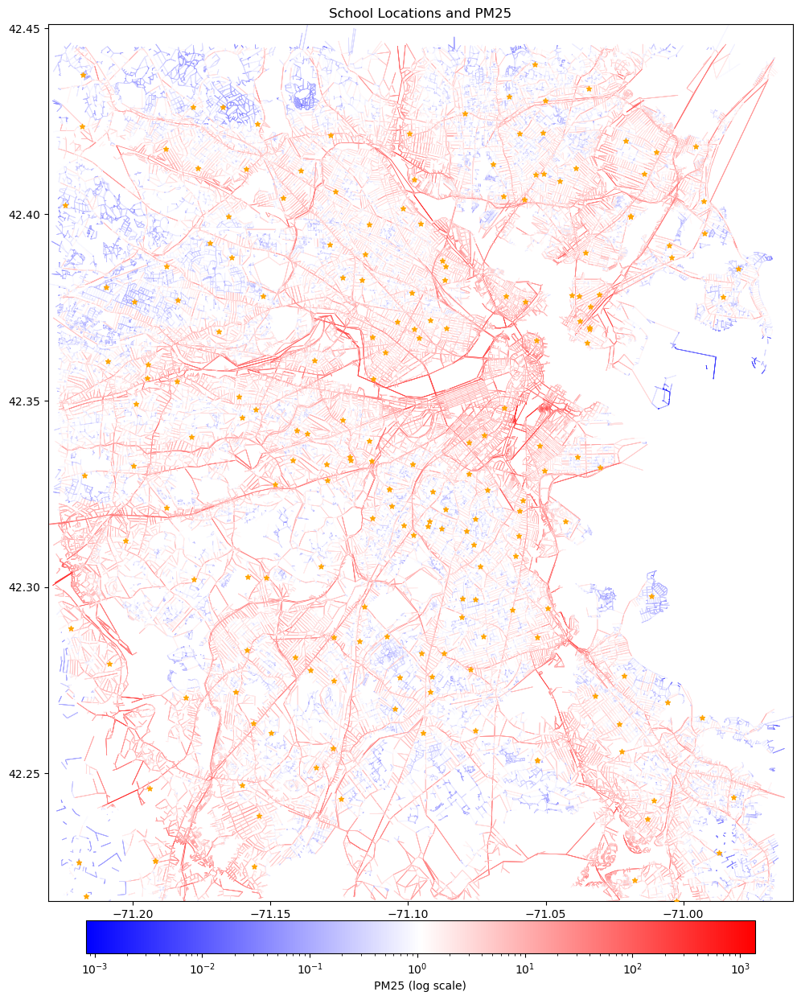

In [27]:
from matplotlib.cm import ScalarMappable
from matplotlib.colors import LogNorm

# Calculate bounds
bounds = gdf_edge_aq_grouped1.total_bounds  # Returns [minx, miny, maxx, maxy]

# Set minimum value for log scale greater than 0
min_value = gdf_edge_aq_grouped1['PM25'][gdf_edge_aq_grouped1['PM25'] > 0].min()
max_value = gdf_edge_aq_grouped1['PM25'].max()

# Apply log normalization
norm = LogNorm(vmin=min_value, vmax=max_value)
cmap = plt.cm.bwr
edge_colors = [cmap(norm(value)) for value in gdf_edge_aq_grouped1['PM25']]

# Plot setup
fig, ax = plt.subplots(figsize=(15, 15))
gdf_edge_aq_grouped1.plot(ax=ax, linewidth=0.5, edgecolor=edge_colors, zorder=1)


# Set the plot limits to the bounds of the road data BEFORE showing the plot
ax.set_xlim(bounds[0], bounds[2])  # Set x limits as minx to maxx
ax.set_ylim(bounds[1], bounds[3])  # Set y limits as miny to maxy

# Add a colorbar with log scale
sm = ScalarMappable(norm=norm, cmap=cmap)
cbar = fig.colorbar(sm, orientation='horizontal', ax=ax, fraction=0.036, pad=0.02)
cbar.set_label('PM25 (log scale)')

# Plot the location of school
sch_bos.plot(ax=ax, marker='*', color='orange', markersize=20, zorder=10)

# Set plot title and show plot
plt.title('School Locations and PM25')
plt.show()

In [28]:
# Calculate the minimum and maximum values of the 'PM25' column
min_value = gdf_edge_aq_grouped1['PM25'].min()
max_value = gdf_edge_aq_grouped1['PM25'].max()

# Print the minimum and maximum values
print("Minimum PM25 value:", min_value)
print("Maximum PM25 value:", max_value)

Minimum PM25 value: 0.000833132
Maximum PM25 value: 1374.79393


In [29]:
def get_color_PM25(value):
    if value <= 5:
        return '#4CAF50'  # Green
    elif value <= 15:
        return '#7CB342'  # Light Green
    elif value <= 35:
        return '#FFEB3B'  # Yellow
    elif value <= 55:
        return '#FF9800'  # Orange
    elif value <= 75:
        return '#FF5722'  # Red
    elif value <= 150:
        return '#F44336'  # Dark Red
    elif value <= 200:
        return '#9C27B0'  # Purple
    else:
        return '#673AB7'  # Deep Purple


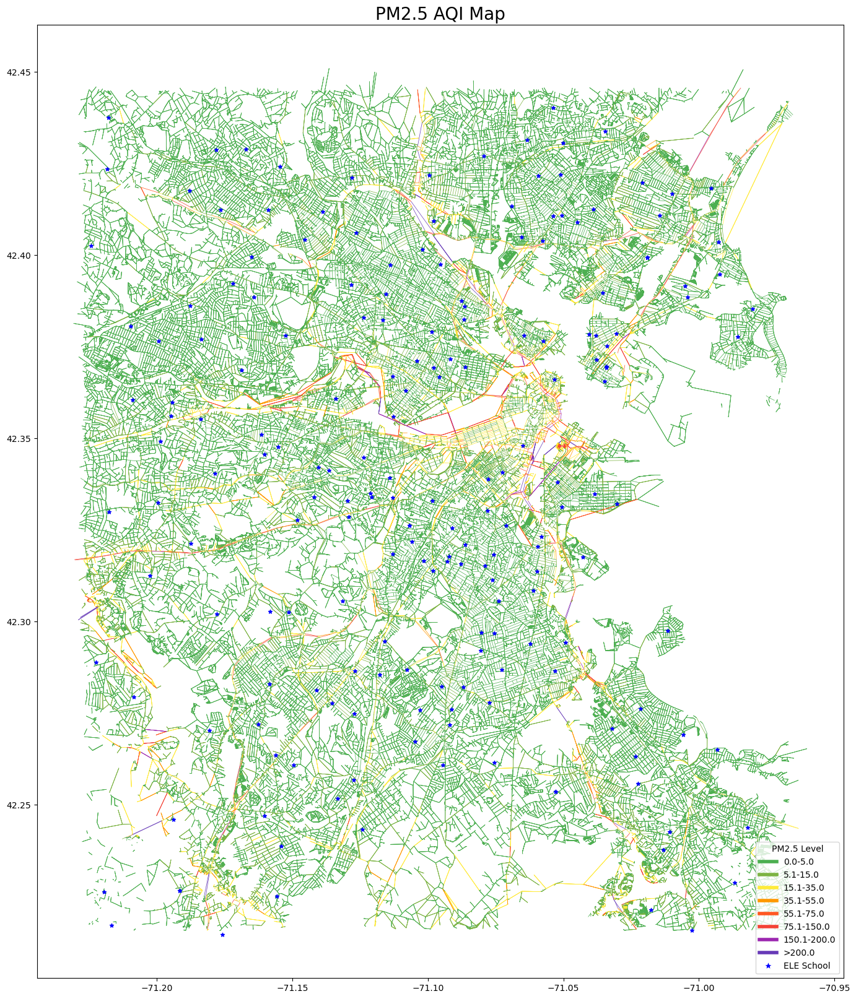

In [30]:
# Assuming gdf_edge_aq_grouped1 is your GeoDataFrame and contains 'PM25' column
gdf_edge_aq_grouped1['color_PM25'] = gdf_edge_aq_grouped1['PM25'].apply(get_color_PM25)

# Convert LineString geometries to a sequence of xy pairs
lines = [np.array(line.xy).T for line in gdf_edge_aq_grouped1.geometry]

# Create a LineCollection with PM25 color coding
colors = gdf_edge_aq_grouped1['color_PM25'].tolist()  # Convert colors to a list

# Plot the air quality lines with a specific zorder
line_collection = LineCollection(lines, colors=colors, linewidths=0.5, zorder=1)  # Air quality lines
fig, ax = plt.subplots(figsize=(20, 20))
ax.add_collection(line_collection)
ax.autoscale()

# Custom legend for PM25 color coding
legend_elements = [
    Line2D([0], [0], color='#4CAF50', lw=4, label='0.0-5.0'),
    Line2D([0], [0], color='#7CB342', lw=4, label='5.1-15.0'),
    Line2D([0], [0], color='#FFEB3B', lw=4, label='15.1-35.0'),
    Line2D([0], [0], color='#FF9800', lw=4, label='35.1-55.0'),
    Line2D([0], [0], color='#FF5722', lw=4, label='55.1-75.0'),
    Line2D([0], [0], color='#F44336', lw=4, label='75.1-150.0'),
    Line2D([0], [0], color='#9C27B0', lw=4, label='150.1-200.0'),
    Line2D([0], [0], color='#673AB7', lw=4, label='>200.0')
]


# Plot bike stations after adding the air quality plot to ensure they appear on top
sch_bos.plot(ax=ax, marker='*', color='blue', markersize=20)  # Bike stations plotted last

# Add the custom legend with the bike stations entry
legend_elements.append(Line2D([0], [0], marker='*', color='w', label='ELE School', markerfacecolor='blue', markersize=10))
ax.legend(handles=legend_elements, loc='lower right', title="PM2.5 Level")

ax.set_title("PM2.5 AQI Map", fontsize=20)

plt.show()

In [31]:
data_map_png_path = r'C:\Users\zliu33\Downloads\data_map_PM25.png'  
fig.savefig(data_map_png_path, dpi=600)

Creat G1

In [32]:
# spatial join network and aq
gdf_edges1_copy = gdf_edges1.copy()

edge_aq_intersect1_copy = gpd.sjoin(gdf_edges1_copy,aq,op='intersects')
edge_aq_intersect1_copy = edge_aq_intersect1_copy.reset_index(['u', 'v', 'key'])
edge_aq_intersect1_copy

C:\JumboConda\lib\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,u,v,key,osmid,oneway,lanes,name,highway,maxspeed,reversed,length,geometry,index_right,FID,RecID,CO,PM25,PM10,NOx_ppb
0,30730954,8246764113,0,3,False,NaN,Logan Memorial Way,residential,25 mph,False,7.148,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
1,30730954,8246764113,1,349120,False,NaN,Logan Memorial Way,residential,25 mph,True,7.148,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
2,30730955,8246764113,0,5,False,NaN,Logan Memorial Way,residential,25 mph,False,2.662,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
3,30730955,8246764113,1,349119,False,NaN,Logan Memorial Way,residential,25 mph,True,2.662,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
4,30730955,5325689133,0,6,False,NaN,NaN,service,NaN,False,46.079,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3309067,11728768467,1522224095,0,385192,True,2,Cambridge Street,primary,25 mph,False,21.473,"LINESTRING (-71.06366 42.36117, -71.06340 42.3...",3194530,66369009,91774,49.8283,0.963176,2.270340,13.84900
3309068,11728814819,11728814820,0,385194,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12195 42.37268, -71.12215 42.3...",3443691,67647249,189523,20.8349,0.389485,0.901769,1.94371
3309069,11728814820,11728814819,0,385196,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12215 42.37275, -71.12195 42.3...",3443691,67647249,189523,20.8349,0.389485,0.901769,1.94371
3309070,11728814819,11728814820,0,385194,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12195 42.37268, -71.12215 42.3...",3445809,67657239,190126,20.7802,0.388964,0.554318,2.04005


In [33]:
edge_aq_grouped1_copy = edge_aq_intersect1_copy.groupby(['u','v','key','geometry']).agg({
    'CO': 'sum',
    'PM25': 'sum',
    'PM10': 'sum',
    'NOx_ppb': 'sum'
}).reset_index().rename(columns={
    'CO': 'CO',
    'PM25': 'PM25',
    'PM10': 'PM10',
    'NOx_ppb': 'NOx_ppb'
})

edge_aq_grouped1_copy

,u,v,key,geometry,CO,PM25,PM10,NOx_ppb
0,30730954,61441677,0,"LINESTRING (-71.02182 42.36761, -71.02175 42.3...",56.3567,0.894345,2.113026,8.98045
1,30730954,8246764113,0,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",26.8622,0.445659,1.005891,4.47591
2,30730954,8246764113,1,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",26.8622,0.445659,1.005891,4.47591
3,30730955,5325689133,0,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",106.6362,1.734852,3.916198,16.92817
4,30730955,5325689133,1,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",106.6362,1.734852,3.916198,16.92817
...,...,...,...,...,...,...,...,...
350859,11728814820,11728814819,0,"LINESTRING (-71.12215 42.37275, -71.12195 42.3...",85.0090,1.594618,3.346881,11.00813
350860,11728814820,11728814821,0,"LINESTRING (-71.12215 42.37275, -71.12205 42.3...",74.0946,1.547198,2.991386,8.59261
350861,11728814820,11728814821,1,"LINESTRING (-71.12215 42.37275, -71.12205 42.3...",74.0946,1.547198,2.991386,8.59261
350862,11728814821,11728814820,0,"LINESTRING (-71.12205 42.37289, -71.12215 42.3...",74.0946,1.547198,2.991386,8.59261


In [34]:
G1_copy = G1.copy()

In [35]:
# Step 1: Ensure correct data types for 'u', 'v', and 'key' in edge_aq_grouped1
#edge_aq_grouped1['u'] = edge_aq_grouped1['u'].astype(int)
#edge_aq_grouped1['v'] = edge_aq_grouped1['v'].astype(int)
#edge_aq_grouped1['key'] = edge_aq_grouped1['key'].astype(int)

# Step 2: Create a dictionary with edge attributes for all pollutants from edge_aq_grouped1
edge_attr_dict = {
    (row['u'], row['v'], row['key']): {
        'CO': row['CO'],
        'PM25': row['PM25'],
        'PM10': row['PM10'],
        'NOx_ppb': row['NOx_ppb']
    }
    for idx, row in edge_aq_grouped1_copy.iterrows()
}

# Step 3: Assign pollutants to the edges in G1 if they exist in edge_attr_dict
for u, v, key, data in G1_copy.edges(keys=True, data=True):
    # Convert u, v, and key to int, assuming they are integers in G1
    u, v, key = int(u), int(v), int(key)
    if (u, v, key) in edge_attr_dict:
        data.update(edge_attr_dict[(u, v, key)])

# Optional: Confirm if NOx_ppb is added
# This will print the first edge data that has NOx_ppb added, for confirmation
for u, v, data in G1_copy.edges(data=True):
    if 'NOx_ppb' in data:
        print(f"Edge from {u} to {v} has the following data: {data}")
        break

Edge from 30730954 to 8246764113 has the following data: {'osmid': 3, 'oneway': False, 'name': 'Logan Memorial Way', 'highway': 'residential', 'maxspeed': '25 mph', 'reversed': False, 'length': 7.148, 'CO': 26.8622, 'PM25': 0.445659, 'PM10': 1.005891, 'NOx_ppb': 4.475910000000001}


In [69]:
gdf_nodes2, gdf_edges2 = ox.utils_graph.graph_to_gdfs(G1_copy, nodes=True, edges=True, node_geometry=True, fill_edge_geometry=True)

In [70]:
gdf_edges2

osmid  oneway lanes                name  \
u           v           key                                             
21321186    472386433   0         0    True     3  Middlesex Turnpike   
21321216    1793674713  0         1   False     2        Summit Drive   
                        1    197940   False     2        Summit Drive   
            8213948692  0         2    True     2  Middlesex Turnpike   
30730954    8246764113  0         3   False   NaN  Logan Memorial Way   
...                             ...     ...   ...                 ...   
11728814820 11728814821 0    385195   False   NaN                 NaN   
                        1    385197   False   NaN                 NaN   
            11728814819 0    385196    True   NaN                 NaN   
11728814821 11728814820 0    385195   False   NaN                 NaN   
                        1    385197   False   NaN                 NaN   

                                  highway maxspeed  reversed   length  \
u           v           key                                             
21321186    472386433   0       secondary   35 mph     False  362.821   
21321216    1793674713  0    unclassified      NaN     False   48.047   
                        1    unclassified      NaN      True   48.047   
            8213948692  0       secondary   35 mph     False   28.484   
30730954    8246764113  0     residential   25 mph     False    7.148   
...                                   ...      ...       ...      ...   
11728814820 11728814821 0         service      NaN     False   17.885   
                        1         service      NaN      True   17.885   
            11728814819 0         service      NaN     False   18.325   
11728814821 11728814820 0         service      NaN      True   17.885   
                        1         service      NaN     False   17.885   

                                  CO      PM25      PM10   NOx_ppb  \
u           v           key                                          
21321186    472386433   0        NaN       NaN       NaN       NaN   
21321216    1793674713  0        NaN       NaN       NaN       NaN   
                        1        NaN       NaN       NaN       NaN   
            8213948692  0        NaN       NaN       NaN       NaN   
30730954    8246764113  0    26.8622  0.445659  1.005891   4.47591   
...                              ...       ...       ...       ...   
11728814820 11728814821 0    74.0946  1.547198  2.991386   8.59261   
                        1    74.0946  1.547198  2.991386   8.59261   
            11728814819 0    85.0090  1.594618  3.346881  11.00813   
11728814821 11728814820 0    74.0946  1.547198  2.991386   8.59261   
                        1    74.0946  1.547198  2.991386   8.59261   

                                                                      geometry  
u           v           key                                                     
21321186    472386433   0    LINESTRING (-71.21951 42.48394, -71.21744 42.4...  
21321216    1793674713  0    LINESTRING (-71.21454 42.47668, -71.21511 42.4...  
                        1    LINESTRING (-71.21454 42.47668, -71.21511 42.4...  
            8213948692  0    LINESTRING (-71.21454 42.47668, -71.21441 42.4...  
30730954    8246764113  0    LINESTRING (-71.02182 42.36761, -71.02184 42.3...  
...                                                                        ...  
11728814820 11728814821 0    LINESTRING (-71.12215 42.37275, -71.12205 42.3...  
                        1    LINESTRING (-71.12215 42.37275, -71.12205 42.3...  
            11728814819 0    LINESTRING (-71.12215 42.37275, -71.12195 42.3...  
11728814821 11728814820 0    LINESTRING (-71.12205 42.37289, -71.12215 42.3...  
                        1    LINESTRING (-71.12205 42.37289, -71.12215 42.3...  

[729346 rows x 13 columns]

In [71]:
gdf_nodes2

,y,x,highway,geometry
osmid,,,,
21321186,42.483945,-71.219512,NaN,POINT (-71.21951 42.48394)
21321216,42.476683,-71.214538,NaN,POINT (-71.21454 42.47668)
30730954,42.367608,-71.021817,NaN,POINT (-71.02182 42.36761)
30730955,42.367523,-71.021849,NaN,POINT (-71.02185 42.36752)
61151272,42.382206,-71.093904,NaN,POINT (-71.09390 42.38221)
...,...,...,...,...
11728768457,42.370857,-71.061268,NaN,POINT (-71.06127 42.37086)
11728768467,42.361174,-71.063657,NaN,POINT (-71.06366 42.36117)
11728814819,42.372678,-71.121951,NaN,POINT (-71.12195 42.37268)


In [72]:
# Count NaN of NOx_ppb
nan_count2 = gdf_edges2['PM25'].isna().sum()

# Print the count of NaN values
print(f"Number of NaN values in 'PM25': {nan_count2}")

# no NaN

Number of NaN values in 'PM25': 378482


In [73]:
gdf_edges2.columns

Index(['osmid', 'oneway', 'lanes', 'name', 'highway', 'maxspeed', 'reversed',
       'length', 'CO', 'PM25', 'PM10', 'NOx_ppb', 'geometry'],
      dtype='object')

In [75]:
non_zero_count2 = (gdf_edges2['NOx_ppb'] != 0).sum() - nan_count2
print(f"Number of non-0 values in 'NOx_ppb': {non_zero_count2}")

Number of non-0 values in 'NOx_ppb': 350864


In [76]:
# Saving G_test as GraphML
ox.save_graphml(G1_copy, filepath=r'C:\Users\zliu33\Downloads\G1_copy.graphml')

Plot NOx

In [36]:
from shapely import wkt

# If the geometry column is in WKT format (as a string), convert it to shapely geometry objects
if isinstance(edge_aq_grouped1_copy['geometry'].iloc[0], str):
    edge_aq_grouped1_copy['geometry'] = edge_aq_grouped1_copy['geometry'].apply(wkt.loads)

# Then convert to GeoDataFrame
gdf_edge_aq_grouped1 = gpd.GeoDataFrame(edge_aq_grouped1_copy, geometry='geometry')

In [39]:
# Calculate the minimum and maximum values of the 'PM25' column
min_value = gdf_edge_aq_grouped1['NOx_ppb'].min()
max_value = gdf_edge_aq_grouped1['NOx_ppb'].max()

# Print the minimum and maximum values
print("Minimum NOx value:", min_value)
print("Maximum NOx value:", max_value)

Minimum PM25 value: 0.0747303
Maximum PM25 value: 13572.9043


In [40]:
def get_color_NOx(value):
    if value <= 50:
        return '#4CAF50'  # Green
    elif value <= 100:
        return '#7CB342'  # Light Green
    elif value <= 150:
        return '#FFEB3B'  # Yellow
    elif value <= 200:
        return '#FF9800'  # Orange
    elif value <= 250:
        return '#FF5722'  # Red
    elif value <= 300:
        return '#F44336'  # Dark Red
    elif value <= 350:
        return '#9C27B0'  # Purple
    else:
        return '#673AB7'  # Deep Purple


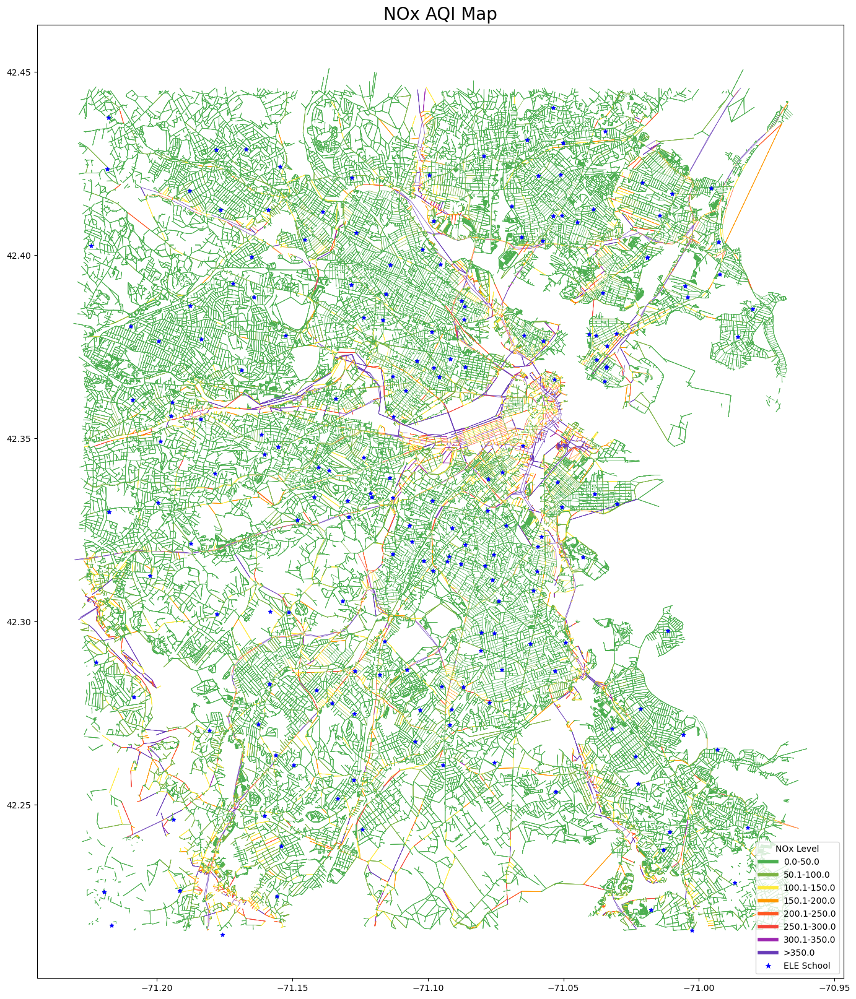

In [41]:
# Assuming gdf_edge_aq_grouped1 is your GeoDataFrame and contains 'PM25' column
gdf_edge_aq_grouped1['color_NOx'] = gdf_edge_aq_grouped1['NOx_ppb'].apply(get_color_NOx)

# Convert LineString geometries to a sequence of xy pairs
lines = [np.array(line.xy).T for line in gdf_edge_aq_grouped1.geometry]

# Create a LineCollection with PM25 color coding
colors = gdf_edge_aq_grouped1['color_NOx'].tolist()  # Convert colors to a list

# Plot the air quality lines with a specific zorder
line_collection = LineCollection(lines, colors=colors, linewidths=0.5, zorder=1)  # Air quality lines
fig, ax = plt.subplots(figsize=(20, 20))
ax.add_collection(line_collection)
ax.autoscale()

# Custom legend for PM25 color coding
legend_elements = [
    Line2D([0], [0], color='#4CAF50', lw=4, label='0.0-50.0'),
    Line2D([0], [0], color='#7CB342', lw=4, label='50.1-100.0'),
    Line2D([0], [0], color='#FFEB3B', lw=4, label='100.1-150.0'),
    Line2D([0], [0], color='#FF9800', lw=4, label='150.1-200.0'),
    Line2D([0], [0], color='#FF5722', lw=4, label='200.1-250.0'),
    Line2D([0], [0], color='#F44336', lw=4, label='250.1-300.0'),
    Line2D([0], [0], color='#9C27B0', lw=4, label='300.1-350.0'),
    Line2D([0], [0], color='#673AB7', lw=4, label='>350.0')
]


# Plot bike stations after adding the air quality plot to ensure they appear on top
sch_bos.plot(ax=ax, marker='*', color='blue', markersize=20)  # Bike stations plotted last

# Add the custom legend with the bike stations entry
legend_elements.append(Line2D([0], [0], marker='*', color='w', label='ELE School', markerfacecolor='blue', markersize=10))
ax.legend(handles=legend_elements, loc='lower right', title="NOx Level")

ax.set_title("NOx AQI Map", fontsize=20)

plt.show()

In [42]:
data_map_png_path = r'C:\Users\zliu33\Downloads\data_map_NOx.png'  
fig.savefig(data_map_png_path, dpi=600)

Plot CO

In [43]:
# Calculate the minimum and maximum values of the 'PM25' column
min_value = gdf_edge_aq_grouped1['CO'].min()
max_value = gdf_edge_aq_grouped1['CO'].max()

# Print the minimum and maximum values
print("Minimum CO value:", min_value)
print("Maximum CO value:", max_value)

Minimum CO value: 0.0629903
Maximum CO value: 82168.324


In [44]:
def get_color_CO(value):
    if value <= 10:
        return '#4CAF50'  # Green
    elif value <= 35:
        return '#7CB342'  # Light Green
    elif value <= 50:
        return '#FFEB3B'  # Yellow
    elif value <= 75:
        return '#FF9800'  # Orange
    elif value <= 100:
        return '#FF5722'  # Red
    elif value <= 150:
        return '#F44336'  # Dark Red
    elif value <= 300:
        return '#9C27B0'  # Purple
    else:
        return '#673AB7'  # Deep Purple


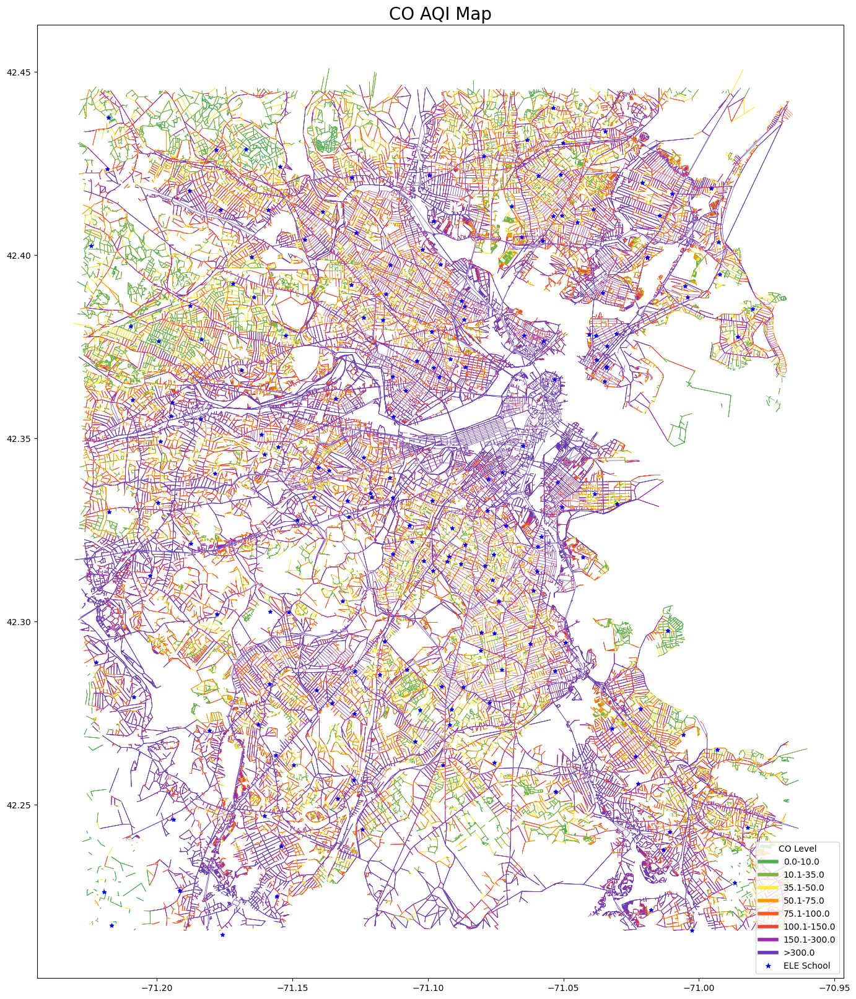

In [45]:
# Assuming gdf_edge_aq_grouped1 is your GeoDataFrame and contains 'PM25' column
gdf_edge_aq_grouped1['color_CO'] = gdf_edge_aq_grouped1['CO'].apply(get_color_CO)

# Convert LineString geometries to a sequence of xy pairs
lines = [np.array(line.xy).T for line in gdf_edge_aq_grouped1.geometry]

# Create a LineCollection with PM25 color coding
colors = gdf_edge_aq_grouped1['color_CO'].tolist()  # Convert colors to a list

# Plot the air quality lines with a specific zorder
line_collection = LineCollection(lines, colors=colors, linewidths=0.5, zorder=1)  # Air quality lines
fig, ax = plt.subplots(figsize=(20, 20))
ax.add_collection(line_collection)
ax.autoscale()

# Custom legend for PM25 color coding
legend_elements = [
    Line2D([0], [0], color='#4CAF50', lw=4, label='0.0-10.0'),
    Line2D([0], [0], color='#7CB342', lw=4, label='10.1-35.0'),
    Line2D([0], [0], color='#FFEB3B', lw=4, label='35.1-50.0'),
    Line2D([0], [0], color='#FF9800', lw=4, label='50.1-75.0'),
    Line2D([0], [0], color='#FF5722', lw=4, label='75.1-100.0'),
    Line2D([0], [0], color='#F44336', lw=4, label='100.1-150.0'),
    Line2D([0], [0], color='#9C27B0', lw=4, label='150.1-300.0'),
    Line2D([0], [0], color='#673AB7', lw=4, label='>300.0')
]


# Plot bike stations after adding the air quality plot to ensure they appear on top
sch_bos.plot(ax=ax, marker='*', color='blue', markersize=20)  # Bike stations plotted last

# Add the custom legend with the bike stations entry
legend_elements.append(Line2D([0], [0], marker='*', color='w', label='ELE School', markerfacecolor='blue', markersize=10))
ax.legend(handles=legend_elements, loc='lower right', title="CO Level")

ax.set_title("CO AQI Map", fontsize=20)

plt.show()

In [46]:
data_map_png_path = r'C:\Users\zliu33\Downloads\data_map_CO.png'  
fig.savefig(data_map_png_path, dpi=600)

In [ ]:
# try avg

In [47]:
# spatial join network and aq
gdf_edges1_copy = gdf_edges1.copy()

edge_aq_intersect1_copy = gpd.sjoin(gdf_edges1_copy,aq,op='intersects')
edge_aq_intersect1_copy = edge_aq_intersect1_copy.reset_index(['u', 'v', 'key'])
edge_aq_intersect1_copy

C:\JumboConda\lib\site-packages\IPython\core\interactiveshell.py:3466: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


,u,v,key,osmid,oneway,lanes,name,highway,maxspeed,reversed,length,geometry,index_right,FID,RecID,CO,PM25,PM10,NOx_ppb
0,30730954,8246764113,0,3,False,NaN,Logan Memorial Way,residential,25 mph,False,7.148,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
1,30730954,8246764113,1,349120,False,NaN,Logan Memorial Way,residential,25 mph,True,7.148,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
2,30730955,8246764113,0,5,False,NaN,Logan Memorial Way,residential,25 mph,False,2.662,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
3,30730955,8246764113,1,349119,False,NaN,Logan Memorial Way,residential,25 mph,True,2.662,"LINESTRING (-71.02185 42.36752, -71.02184 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
4,30730955,5325689133,0,6,False,NaN,NaN,service,NaN,False,46.079,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",3324186,67078642,126688,12.2057,0.202321,0.455695,2.23850
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3309067,11728768467,1522224095,0,385192,True,2,Cambridge Street,primary,25 mph,False,21.473,"LINESTRING (-71.06366 42.36117, -71.06340 42.3...",3194530,66369009,91774,49.8283,0.963176,2.270340,13.84900
3309068,11728814819,11728814820,0,385194,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12195 42.37268, -71.12215 42.3...",3443691,67647249,189523,20.8349,0.389485,0.901769,1.94371
3309069,11728814820,11728814819,0,385196,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12215 42.37275, -71.12195 42.3...",3443691,67647249,189523,20.8349,0.389485,0.901769,1.94371
3309070,11728814819,11728814820,0,385194,True,NaN,NaN,service,NaN,False,18.325,"LINESTRING (-71.12195 42.37268, -71.12215 42.3...",3445809,67657239,190126,20.7802,0.388964,0.554318,2.04005


In [48]:
edge_aq_grouped1_copy = edge_aq_intersect1_copy.groupby(['u','v','key','geometry']).agg({
    'CO': 'mean',
    'PM25': 'mean',
    'PM10': 'mean',
    'NOx_ppb': 'mean'
}).reset_index().rename(columns={
    'CO': 'CO_avg',
    'PM25': 'PM25_avg',
    'PM10': 'PM10_avg',
    'NOx_ppb': 'NOx_ppb_avg'
})

edge_aq_grouped1_copy


,u,v,key,geometry,CO_avg,PM25_avg,PM10_avg,NOx_ppb_avg
0,30730954,61441677,0,"LINESTRING (-71.02182 42.36761, -71.02175 42.3...",14.089175,0.223586,0.528257,2.245112
1,30730954,8246764113,0,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",13.431100,0.222830,0.502946,2.237955
2,30730954,8246764113,1,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",13.431100,0.222830,0.502946,2.237955
3,30730955,5325689133,0,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",15.233743,0.247836,0.559457,2.418310
4,30730955,5325689133,1,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",15.233743,0.247836,0.559457,2.418310
...,...,...,...,...,...,...,...,...
350859,11728814820,11728814819,0,"LINESTRING (-71.12215 42.37275, -71.12195 42.3...",21.252250,0.398655,0.836720,2.752032
350860,11728814820,11728814821,0,"LINESTRING (-71.12215 42.37275, -71.12205 42.3...",18.523650,0.386799,0.747847,2.148153
350861,11728814820,11728814821,1,"LINESTRING (-71.12215 42.37275, -71.12205 42.3...",18.523650,0.386799,0.747847,2.148153
350862,11728814821,11728814820,0,"LINESTRING (-71.12205 42.37289, -71.12215 42.3...",18.523650,0.386799,0.747847,2.148153


In [51]:
print(edge_aq_grouped1_copy.columns)


Index(['u', 'v', 'key', 'geometry', 'CO_avg', 'PM25_avg', 'PM10_avg',
       'NOx_ppb_avg'],
      dtype='object')


In [49]:
G1_copy = G1.copy()

In [52]:
# Step 1: Ensure correct data types for 'u', 'v', and 'key' in edge_aq_grouped1
#edge_aq_grouped1['u'] = edge_aq_grouped1['u'].astype(int)
#edge_aq_grouped1['v'] = edge_aq_grouped1['v'].astype(int)
#edge_aq_grouped1['key'] = edge_aq_grouped1['key'].astype(int)

# Step 2: Create a dictionary with edge attributes for all pollutants from edge_aq_grouped1
edge_attr_dict = {
    (row['u'], row['v'], row['key']): {
        'CO': row['CO_avg'],
        'PM25': row['PM25_avg'],
        'PM10': row['PM10_avg'],
        'NOx_ppb': row['NOx_ppb_avg']
    }
    for idx, row in edge_aq_grouped1_copy.iterrows()
}


# Step 3: Assign pollutants to the edges in G1 if they exist in edge_attr_dict
for u, v, key, data in G1_copy.edges(keys=True, data=True):
    # Convert u, v, and key to int, assuming they are integers in G1
    u, v, key = int(u), int(v), int(key)
    if (u, v, key) in edge_attr_dict:
        data.update(edge_attr_dict[(u, v, key)])

# Optional: Confirm if NOx_ppb is added
# This will print the first edge data that has NOx_ppb added, for confirmation
for u, v, data in G1_copy.edges(data=True):
    if 'NOx_ppb' in data:
        print(f"Edge from {u} to {v} has the following data: {data}")
        break

Edge from 30730954 to 8246764113 has the following data: {'osmid': 3, 'oneway': False, 'name': 'Logan Memorial Way', 'highway': 'residential', 'maxspeed': '25 mph', 'reversed': False, 'length': 7.148, 'CO': 13.4311, 'PM25': 0.2228295, 'PM10': 0.5029455, 'NOx_ppb': 2.2379550000000004}


In [54]:
edge_aq_grouped1_copy.head()

,u,v,key,geometry,CO_avg,PM25_avg,PM10_avg,NOx_ppb_avg
0,30730954,61441677,0,"LINESTRING (-71.02182 42.36761, -71.02175 42.3...",14.089175,0.223586,0.528257,2.245112
1,30730954,8246764113,0,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",13.431100,0.222830,0.502946,2.237955
2,30730954,8246764113,1,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",13.431100,0.222830,0.502946,2.237955
3,30730955,5325689133,0,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",15.233743,0.247836,0.559457,2.418310
4,30730955,5325689133,1,"LINESTRING (-71.02185 42.36752, -71.02233 42.3...",15.233743,0.247836,0.559457,2.418310


In [55]:
edge_aq_grouped1_copy[(edge_aq_grouped1_copy['u'] == 30730954)]

,u,v,key,geometry,CO_avg,PM25_avg,PM10_avg,NOx_ppb_avg
0,30730954,61441677,0,"LINESTRING (-71.02182 42.36761, -71.02175 42.3...",14.089175,0.223586,0.528257,2.245112
1,30730954,8246764113,0,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",13.431100,0.222830,0.502946,2.237955
2,30730954,8246764113,1,"LINESTRING (-71.02182 42.36761, -71.02184 42.3...",13.431100,0.222830,0.502946,2.237955


In [56]:
from shapely import wkt

# If the geometry column is in WKT format (as a string), convert it to shapely geometry objects
if isinstance(edge_aq_grouped1_copy['geometry'].iloc[0], str):
    edge_aq_grouped1_copy['geometry'] = edge_aq_grouped1_copy['geometry'].apply(wkt.loads)

# Then convert to GeoDataFrame
gdf_edge_aq_grouped1 = gpd.GeoDataFrame(edge_aq_grouped1_copy, geometry='geometry')

In [58]:
# Calculate the minimum and maximum values of the 'PM25' column
min_value = gdf_edge_aq_grouped1['CO_avg'].min()
max_value = gdf_edge_aq_grouped1['CO_avg'].max()

# Print the minimum and maximum values
print("Minimum CO value:", min_value)
print("Maximum CO value:", max_value)

Minimum CO value: 0.020996766666666666
Maximum CO value: 1138.3933333333332


In [59]:
def get_color_CO(value):
    if value <= 10:
        return '#4CAF50'  # Green
    elif value <= 35:
        return '#7CB342'  # Light Green
    elif value <= 50:
        return '#FFEB3B'  # Yellow
    elif value <= 75:
        return '#FF9800'  # Orange
    elif value <= 100:
        return '#FF5722'  # Red
    elif value <= 150:
        return '#F44336'  # Dark Red
    elif value <= 300:
        return '#9C27B0'  # Purple
    else:
        return '#673AB7'  # Deep Purple


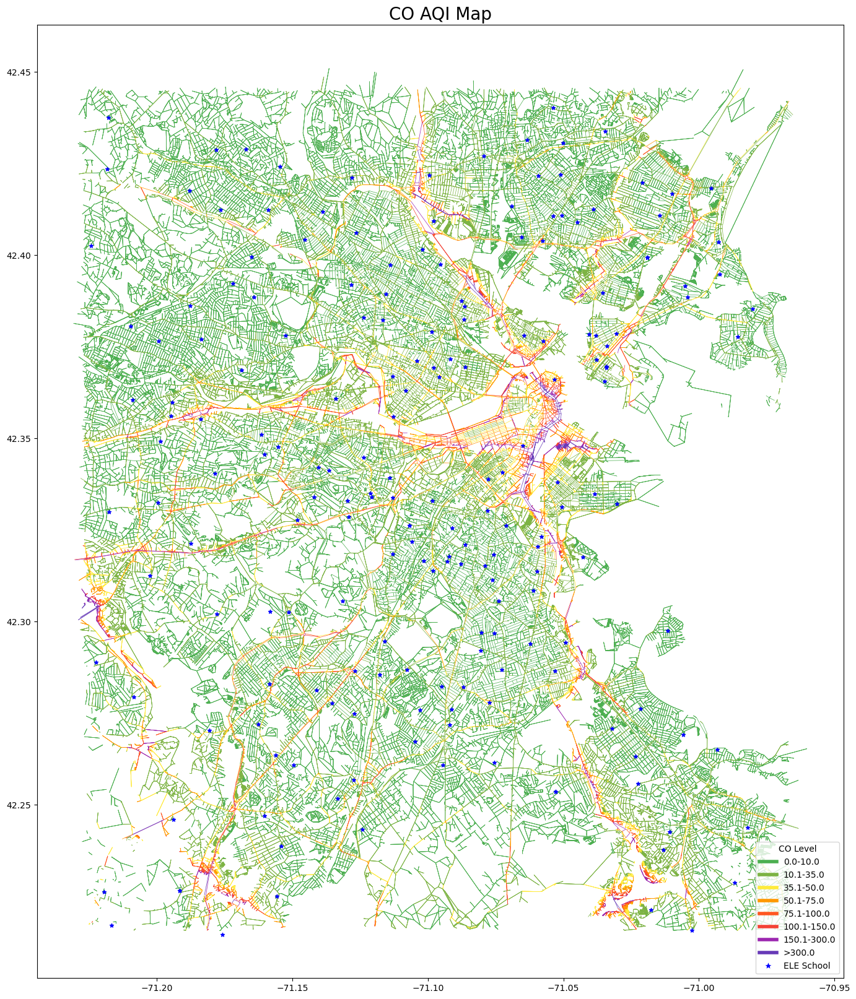

In [61]:
# Assuming gdf_edge_aq_grouped1 is your GeoDataFrame and contains 'PM25' column
gdf_edge_aq_grouped1['color_CO'] = gdf_edge_aq_grouped1['CO_avg'].apply(get_color_CO)

# Convert LineString geometries to a sequence of xy pairs
lines = [np.array(line.xy).T for line in gdf_edge_aq_grouped1.geometry]

# Create a LineCollection with PM25 color coding
colors = gdf_edge_aq_grouped1['color_CO'].tolist()  # Convert colors to a list

# Plot the air quality lines with a specific zorder
line_collection = LineCollection(lines, colors=colors, linewidths=0.5, zorder=1)  # Air quality lines
fig, ax = plt.subplots(figsize=(20, 20))
ax.add_collection(line_collection)
ax.autoscale()

# Custom legend for PM25 color coding
legend_elements = [
    Line2D([0], [0], color='#4CAF50', lw=4, label='0.0-10.0'),
    Line2D([0], [0], color='#7CB342', lw=4, label='10.1-35.0'),
    Line2D([0], [0], color='#FFEB3B', lw=4, label='35.1-50.0'),
    Line2D([0], [0], color='#FF9800', lw=4, label='50.1-75.0'),
    Line2D([0], [0], color='#FF5722', lw=4, label='75.1-100.0'),
    Line2D([0], [0], color='#F44336', lw=4, label='100.1-150.0'),
    Line2D([0], [0], color='#9C27B0', lw=4, label='150.1-300.0'),
    Line2D([0], [0], color='#673AB7', lw=4, label='>300.0')
]


# Plot bike stations after adding the air quality plot to ensure they appear on top
sch_bos.plot(ax=ax, marker='*', color='blue', markersize=20)  # Bike stations plotted last

# Add the custom legend with the bike stations entry
legend_elements.append(Line2D([0], [0], marker='*', color='w', label='ELE School', markerfacecolor='blue', markersize=10))
ax.legend(handles=legend_elements, loc='lower right', title="CO Level")

ax.set_title("CO AQI Map", fontsize=20)

plt.show()

In [62]:
data_map_png_path = r'C:\Users\zliu33\Downloads\data_map_CO_avg.png'  
fig.savefig(data_map_png_path, dpi=600)

In [ ]:
# for pm25

In [73]:
# Calculate the minimum and maximum values of the 'PM25' column
min_value = gdf_edge_aq_grouped1['PM25_avg'].min()
max_value = gdf_edge_aq_grouped1['PM25_avg'].max()

# Print the minimum and maximum values
print("Minimum PM25 value:", min_value)
print("Maximum PM25 value:", max_value)

Minimum PM25 value: 0.000269650875
Maximum PM25 value: 19.29296666666667


In [74]:
def get_color_PM25(value):
    if value <= 0.3:
        return '#4CAF50'  # Green
    elif value <= 0.5:
        return '#7CB342'  # Light Green
    elif value <= 0.7:
        return '#FFEB3B'  # Yellow
    elif value <= 1:
        return '#FF9800'  # Orange
    elif value <= 3:
        return '#FF5722'  # Red
    elif value <= 5:
        return '#F44336'  # Dark Red
    elif value <= 10:
        return '#9C27B0'  # Purple
    else:
        return '#673AB7'  # Deep Purple

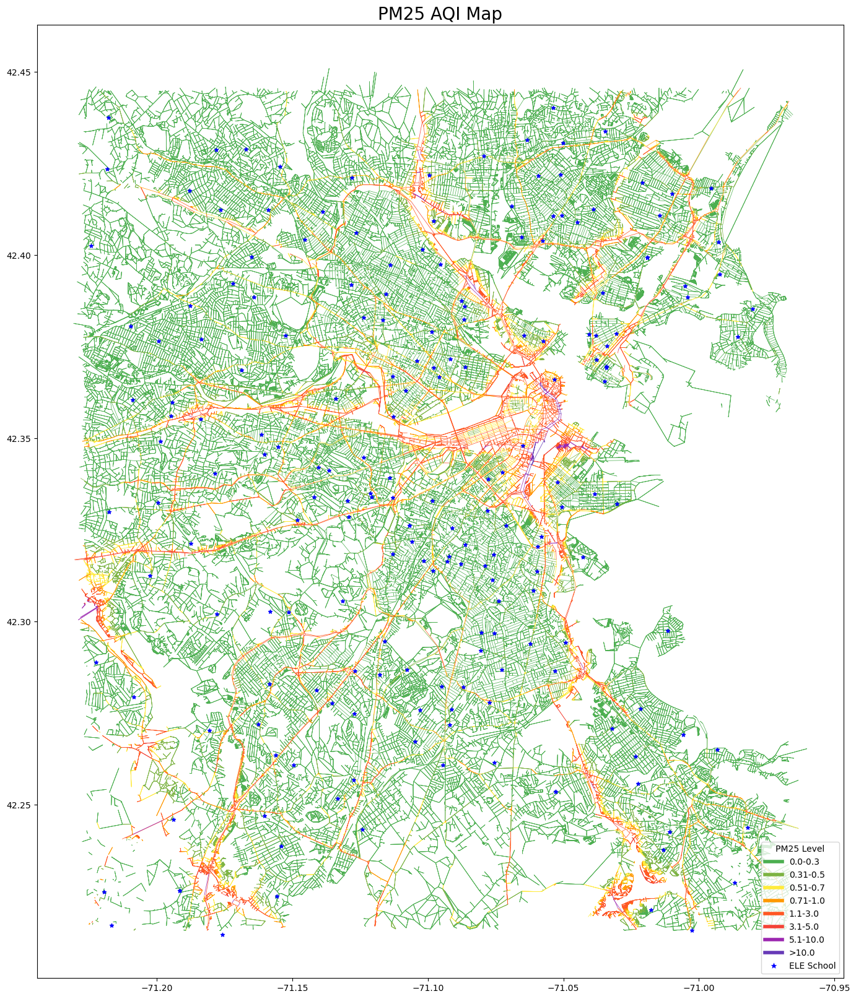

In [76]:
# Assuming gdf_edge_aq_grouped1 is your GeoDataFrame and contains 'PM25' column
gdf_edge_aq_grouped1['color_PM25'] = gdf_edge_aq_grouped1['PM25_avg'].apply(get_color_PM25)

# Convert LineString geometries to a sequence of xy pairs
lines = [np.array(line.xy).T for line in gdf_edge_aq_grouped1.geometry]

# Create a LineCollection with PM25 color coding
colors = gdf_edge_aq_grouped1['color_PM25'].tolist()  # Convert colors to a list

# Plot the air quality lines with a specific zorder
line_collection = LineCollection(lines, colors=colors, linewidths=0.5, zorder=1)  # Air quality lines
fig, ax = plt.subplots(figsize=(20, 20))
ax.add_collection(line_collection)
ax.autoscale()

# Custom legend for PM25 color coding
legend_elements = [
    Line2D([0], [0], color='#4CAF50', lw=4, label='0.0-0.3'),
    Line2D([0], [0], color='#7CB342', lw=4, label='0.31-0.5'),
    Line2D([0], [0], color='#FFEB3B', lw=4, label='0.51-0.7'),
    Line2D([0], [0], color='#FF9800', lw=4, label='0.71-1.0'),
    Line2D([0], [0], color='#FF5722', lw=4, label='1.1-3.0'),
    Line2D([0], [0], color='#F44336', lw=4, label='3.1-5.0'),
    Line2D([0], [0], color='#9C27B0', lw=4, label='5.1-10.0'),
    Line2D([0], [0], color='#673AB7', lw=4, label='>10.0')
]


# Plot bike stations after adding the air quality plot to ensure they appear on top
sch_bos.plot(ax=ax, marker='*', color='blue', markersize=20)  # Bike stations plotted last

# Add the custom legend with the bike stations entry
legend_elements.append(Line2D([0], [0], marker='*', color='w', label='ELE School', markerfacecolor='blue', markersize=10))
ax.legend(handles=legend_elements, loc='lower right', title="PM25 Level")

ax.set_title("PM25 AQI Map", fontsize=20)

plt.show()

In [77]:
data_map_png_path = r'C:\Users\zliu33\Downloads\data_map_PM25_avg.png'  
fig.savefig(data_map_png_path, dpi=600)

In [ ]:
#for PM10

In [70]:
# Calculate the minimum and maximum values of the 'PM25' column
min_value = gdf_edge_aq_grouped1['PM10_avg'].min()
max_value = gdf_edge_aq_grouped1['PM10_avg'].max()

# Print the minimum and maximum values
print("Minimum PM10 value:", min_value)
print("Maximum PM10 value:", max_value)

Minimum PM10 value: 0.0008397896666666667
Maximum PM10 value: 43.5157


In [80]:
def get_color_PM10(value):
    if value <= 0.5:
        return '#4CAF50'  # Green
    elif value <= 1:
        return '#7CB342'  # Light Green
    elif value <= 3:
        return '#FFEB3B'  # Yellow
    elif value <= 5:
        return '#FF9800'  # Orange
    elif value <= 7:
        return '#FF5722'  # Red
    elif value <= 9:
        return '#F44336'  # Dark Red
    elif value <= 15:
        return '#9C27B0'  # Purple
    else:
        return '#673AB7'  # Deep Purple

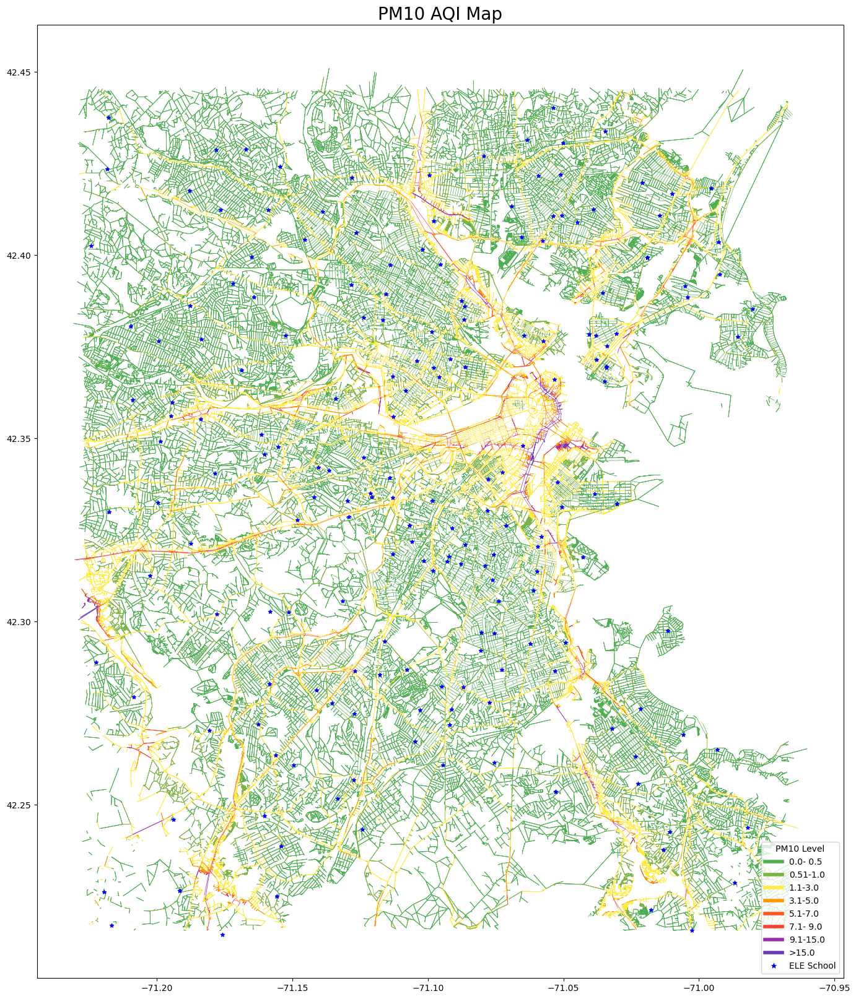

In [82]:
# Assuming gdf_edge_aq_grouped1 is your GeoDataFrame and contains 'PM25' column
gdf_edge_aq_grouped1['color_PM10'] = gdf_edge_aq_grouped1['PM10_avg'].apply(get_color_PM10)

# Convert LineString geometries to a sequence of xy pairs
lines = [np.array(line.xy).T for line in gdf_edge_aq_grouped1.geometry]

# Create a LineCollection with PM25 color coding
colors = gdf_edge_aq_grouped1['color_PM10'].tolist()  # Convert colors to a list

# Plot the air quality lines with a specific zorder
line_collection = LineCollection(lines, colors=colors, linewidths=0.5, zorder=1)  # Air quality lines
fig, ax = plt.subplots(figsize=(20, 20))
ax.add_collection(line_collection)
ax.autoscale()

# Custom legend for PM25 color coding
legend_elements = [
    Line2D([0], [0], color='#4CAF50', lw=4, label='0.0- 0.5'),
    Line2D([0], [0], color='#7CB342', lw=4, label='0.51-1.0'),
    Line2D([0], [0], color='#FFEB3B', lw=4, label='1.1-3.0'),
    Line2D([0], [0], color='#FF9800', lw=4, label='3.1-5.0'),
    Line2D([0], [0], color='#FF5722', lw=4, label='5.1-7.0'),
    Line2D([0], [0], color='#F44336', lw=4, label='7.1- 9.0'),
    Line2D([0], [0], color='#9C27B0', lw=4, label='9.1-15.0'),
    Line2D([0], [0], color='#673AB7', lw=4, label='>15.0')
]


# Plot bike stations after adding the air quality plot to ensure they appear on top
sch_bos.plot(ax=ax, marker='*', color='blue', markersize=20)  # Bike stations plotted last

# Add the custom legend with the bike stations entry
legend_elements.append(Line2D([0], [0], marker='*', color='w', label='ELE School', markerfacecolor='blue', markersize=10))
ax.legend(handles=legend_elements, loc='lower right', title="PM10 Level")

ax.set_title("PM10 AQI Map", fontsize=20)

plt.show()

In [83]:
data_map_png_path = r'C:\Users\zliu33\Downloads\data_map_PM10_avg.png'  
fig.savefig(data_map_png_path, dpi=600)

In [ ]:
# Plot NOx avg

In [84]:
# Calculate the minimum and maximum values of the 'PM25' column
min_value = gdf_edge_aq_grouped1['NOx_ppb_avg'].min()
max_value = gdf_edge_aq_grouped1['NOx_ppb_avg'].max()

# Print the minimum and maximum values
print("Minimum PM25 value:", min_value)
print("Maximum PM25 value:", max_value)

Minimum PM25 value: 0.03553585714285714
Maximum PM25 value: 199.24433333333332


In [88]:
def get_color_NOx(value):
    if value <= 1:
        return '#4CAF50'  # Green
    elif value <= 5:
        return '#7CB342'  # Light Green
    elif value <= 10:
        return '#FFEB3B'  # Yellow
    elif value <= 20:
        return '#FF9800'  # Orange
    elif value <= 50:
        return '#FF5722'  # Red
    elif value <= 100:
        return '#F44336'  # Dark Red
    elif value <= 150:
        return '#9C27B0'  # Purple
    else:
        return '#673AB7'  # Deep Purple


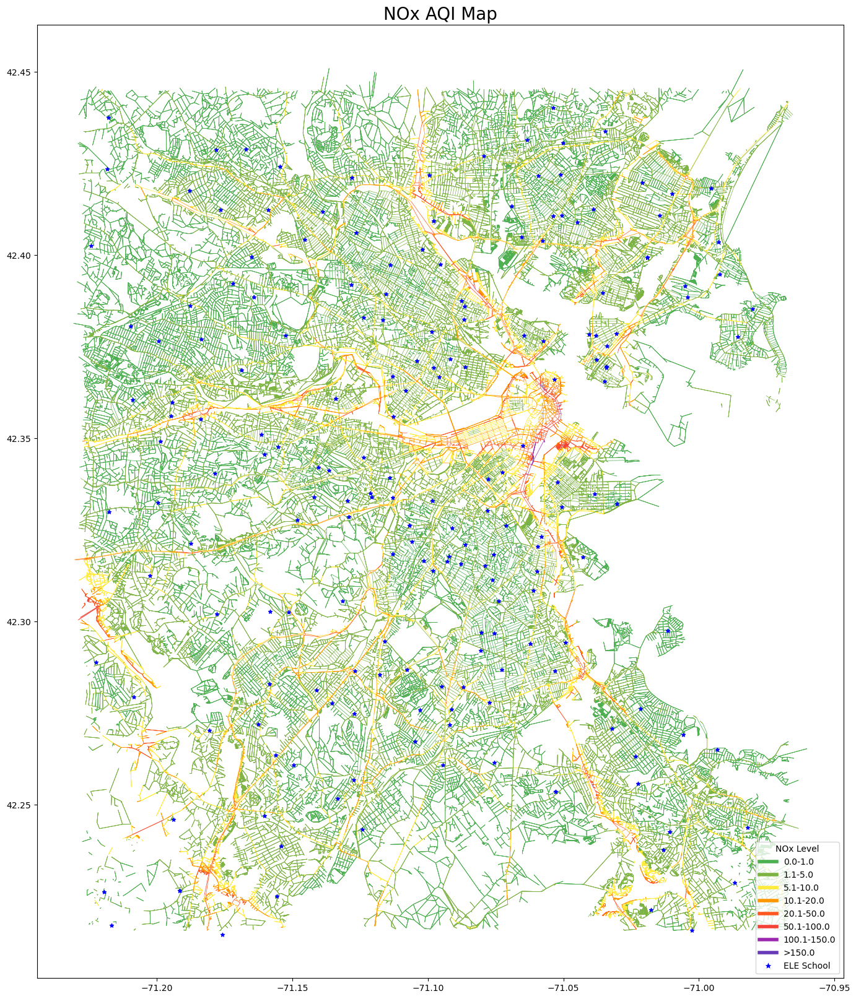

In [89]:
# Assuming gdf_edge_aq_grouped1 is your GeoDataFrame and contains 'PM25' column
gdf_edge_aq_grouped1['color_NOx'] = gdf_edge_aq_grouped1['NOx_ppb_avg'].apply(get_color_NOx)

# Convert LineString geometries to a sequence of xy pairs
lines = [np.array(line.xy).T for line in gdf_edge_aq_grouped1.geometry]

# Create a LineCollection with PM25 color coding
colors = gdf_edge_aq_grouped1['color_NOx'].tolist()  # Convert colors to a list

# Plot the air quality lines with a specific zorder
line_collection = LineCollection(lines, colors=colors, linewidths=0.5, zorder=1)  # Air quality lines
fig, ax = plt.subplots(figsize=(20, 20))
ax.add_collection(line_collection)
ax.autoscale()

# Custom legend for PM25 color coding
legend_elements = [
    Line2D([0], [0], color='#4CAF50', lw=4, label='0.0-1.0'),
    Line2D([0], [0], color='#7CB342', lw=4, label='1.1-5.0'),
    Line2D([0], [0], color='#FFEB3B', lw=4, label='5.1-10.0'),
    Line2D([0], [0], color='#FF9800', lw=4, label='10.1-20.0'),
    Line2D([0], [0], color='#FF5722', lw=4, label='20.1-50.0'),
    Line2D([0], [0], color='#F44336', lw=4, label='50.1-100.0'),
    Line2D([0], [0], color='#9C27B0', lw=4, label='100.1-150.0'),
    Line2D([0], [0], color='#673AB7', lw=4, label='>150.0')
]


# Plot bike stations after adding the air quality plot to ensure they appear on top
sch_bos.plot(ax=ax, marker='*', color='blue', markersize=20)  # Bike stations plotted last

# Add the custom legend with the bike stations entry
legend_elements.append(Line2D([0], [0], marker='*', color='w', label='ELE School', markerfacecolor='blue', markersize=10))
ax.legend(handles=legend_elements, loc='lower right', title="NOx Level")

ax.set_title("NOx AQI Map", fontsize=20)

plt.show()

In [90]:
data_map_png_path = r'C:\Users\zliu33\Downloads\data_map_NOx_avg.png'  
fig.savefig(data_map_png_path, dpi=600)